In [1]:
import pandas as pd

In [2]:
train_df = (pd.read_csv("../input/train.csv")
           )

In [3]:
train_df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Prediction,Time,Summary,Text
0,492346,B001VNP0Y6,AEZRVY3CV52UZ,"Corey Wright ""Democratus""",3,3,5,1320537600,Just what I needed,I got them in a very timely manner and they're...
1,343811,B008J1HO4C,A18VZYSLOUO060,"D. Simpson ""Frugal SOB""",2,2,5,1204329600,Most excellent oatmeal,McCann's Steel Cut Oatmeal is the perfect brea...
2,347257,B000FFIL60,A28Y1M7GRG0I9M,"Real Comments ""Lin""",0,0,4,1318464000,Quality Tea,I would recommend it. Quality pearls and a few...
3,225529,B002ZX1U9A,A245HC4T5J97WG,Logan DeAngelis,0,0,5,1306540800,Great Coffee at a Great price,"I have to admit, I first purchased these Hazel..."
4,485488,B001RVFERK,AVABPJCKE2MR5,spal,0,0,4,1314921600,Popchips Jalapeno flavor,I bought a case of jalapeno chips as I love th...


In [4]:
train_sampled = train_df.sample(n=int(train_df.shape[0] / 1000))

In [5]:
from altair import Chart, X, Y

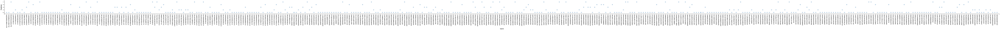

In [6]:
Chart(train_sampled).mark_point().encode(
    x='UserId',
    y='Prediction:O'
)

In [7]:
train_df.UserId.describe()

count             454760
unique            219806
top       A3OXHLG6DIBRW8
freq                 345
Name: UserId, dtype: object

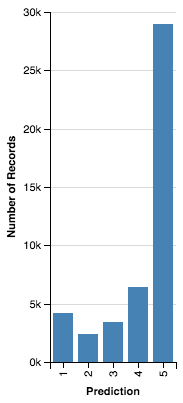

In [8]:
Chart(train_df.sample(n=int(train_df.shape[0] / 10))).mark_bar().encode(
    x='Prediction:O',
    y=Y('count(*):Q')
)

In [9]:
train_df.ProductId.describe()

count         454760
unique         67726
top       B007JFMH8M
freq             714
Name: ProductId, dtype: object

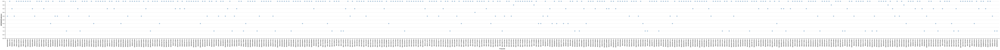

In [10]:
Chart(train_sampled).mark_point().encode(
    x='ProductId',
    y=Y('average(Prediction)')
)

In [11]:
test_df = pd.read_csv("../input/test.csv")

In [12]:
print("Unique users in train: {}\nUnique users in test: {}\nUnique users in train and in test: {}".format(len(set(train_df.UserId)), len(set(test_df.UserId)), len(set(train_df.UserId).intersection(set(test_df.UserId)))))

Unique users in train: 219806
Unique users in test: 78985
Unique users in train and in test: 42734


In [ ]:
print("Unique users in train and in test: {}".format(len(set(train_df.UserId).intersection(set(test_df.UserId)))))

In [3]:
import sys
sys.path.append("../src")
from recsys import RecSys

/Users/dpetrov/.anaconda/lib/python3.5/site-packages/lightfm/_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn('LightFM was compiled without OpenMP support. '


In [4]:
rs = RecSys("UserId", "ProductId", "Prediction")

In [ ]:
rs.fit(train_df)